## Importando Bibliotecas

In [1]:
import json
import matplotlib.pyplot as plt
import cv2
import numpy as np
import os
import random
import yaml
import math

## Carregando Dataset

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
!unzip "/content/drive/MyDrive/Módulo-9/Pose estimation S7/animal-pose-estimation.zip"
# !unzip "/content/animal-pose-estimation.zip"

Archive:  /content/drive/MyDrive/Módulo-9/Pose estimation S7/animal-pose-estimation.zip
  inflating: images/images/2007_000063.jpg  
  inflating: images/images/2007_000175.jpg  
  inflating: images/images/2007_000332.jpg  
  inflating: images/images/2007_000392.jpg  
  inflating: images/images/2007_000464.jpg  
  inflating: images/images/2007_000491.jpg  
  inflating: images/images/2007_000504.jpg  
  inflating: images/images/2007_000528.jpg  
  inflating: images/images/2007_000549.jpg  
  inflating: images/images/2007_000676.jpg  
  inflating: images/images/2007_000720.jpg  
  inflating: images/images/2007_000783.jpg  
  inflating: images/images/2007_000799.jpg  
  inflating: images/images/2007_000836.jpg  
  inflating: images/images/2007_000876.jpg  
  inflating: images/images/2007_000904.jpg  
  inflating: images/images/2007_000925.jpg  
  inflating: images/images/2007_001073.jpg  
  inflating: images/images/2007_001185.jpg  
  inflating: images/images/2007_001225.jpg  
  inflating

Lendo o keypoints.json

In [4]:
import json

with open('/content/keypoints.json', 'r') as f:
    data = json.load(f)


with open('keypoints.yaml', 'w') as file:
    yaml.dump(data, file, sort_keys=False, allow_unicode=True)


## 1. Análise exploratória

O dataset está divido em:

*   images
*   annotations
*   categories
*   infos





In [5]:
# Informações do dataset
data.keys()

dict_keys(['images', 'annotations', 'categories', 'info'])


data['images']

Contém um dicionário que relaciona image_id com o nome da imagem

In [6]:
data['images']

{'1': '2007_000063.jpg',
 '2': '2007_000175.jpg',
 '3': '2007_000332.jpg',
 '4': '2007_000392.jpg',
 '5': '2007_000464.jpg',
 '6': '2007_000491.jpg',
 '7': '2007_000504.jpg',
 '8': '2007_000528.jpg',
 '9': '2007_000549.jpg',
 '10': '2007_000676.jpg',
 '11': '2007_000720.jpg',
 '12': '2007_000783.jpg',
 '13': '2007_000799.jpg',
 '14': '2007_000836.jpg',
 '15': '2007_000876.jpg',
 '16': '2007_000904.jpg',
 '17': '2007_000925.jpg',
 '18': '2007_001073.jpg',
 '19': '2007_001185.jpg',
 '20': '2007_001416.jpg',
 '21': '2007_001225.jpg',
 '22': '2007_001239.jpg',
 '23': '2007_001299.jpg',
 '24': '2007_001340.jpg',
 '25': '2007_001397.jpg',
 '26': '2007_001586.jpg',
 '27': '2007_001594.jpg',
 '28': '2007_001420.jpg',
 '29': '2007_001724.jpg',
 '30': '2007_001733.jpg',
 '31': '2007_001764.jpg',
 '32': '2007_001774.jpg',
 '33': '2007_001917.jpg',
 '34': '2007_001955.jpg',
 '35': '2007_002387.jpg',
 '36': '2007_002648.jpg',
 '37': '2007_003189.jpg',
 '38': '2007_001763.jpg',
 '39': '2007_003194.j

data['annotations']
contém um dicionário com informações de cada imagem, como image_id, coordenadas da bouding box, coordenadas dos keypoints que formam a pose estimation do animal e category_id que informa a espécie do animal

In [7]:
data['annotations'][0:4]

[{'image_id': 1,
  'bbox': [123, 115, 379, 275],
  'keypoints': [[193, 216, 1],
   [160, 217, 1],
   [174, 261, 1],
   [204, 186, 1],
   [152, 182, 1],
   [0, 0, 0],
   [0, 0, 0],
   [273, 168, 1],
   [0, 0, 0],
   [0, 0, 0],
   [0, 0, 0],
   [266, 225, 1],
   [0, 0, 0],
   [0, 0, 0],
   [0, 0, 0],
   [0, 0, 0],
   [0, 0, 0],
   [0, 0, 0],
   [190, 145, 1],
   [351, 238, 1]],
  'num_keypoints': 20,
  'category_id': 1},
 {'image_id': 2,
  'bbox': [25, 34, 419, 271],
  'keypoints': [[330, 84, 1],
   [245, 91, 1],
   [290, 137, 1],
   [340, 71, 1],
   [225, 91, 1],
   [325, 223, 1],
   [168, 196, 1],
   [0, 0, 0],
   [94, 134, 1],
   [325, 253, 1],
   [166, 256, 1],
   [0, 0, 0],
   [53, 188, 1],
   [0, 0, 0],
   [0, 0, 0],
   [0, 0, 0],
   [41, 209, 1],
   [285, 202, 1],
   [0, 0, 0],
   [0, 0, 0]],
  'num_keypoints': 20,
  'category_id': 3},
 {'image_id': 3,
  'bbox': [54, 50, 285, 262],
  'keypoints': [[275, 102, 1],
   [247, 105, 1],
   [269, 156, 1],
   [271, 71, 1],
   [241, 78, 1],

data['categories']
Informa a espécie de cada animal e seu category_id.
Nota-se que o category_id dos bovinos é 5.

In [8]:
data['categories']

[{'supercategory': 'animal',
  'id': 1,
  'name': 'dog',
  'keypoints': ['left_eye',
   'right_eye',
   'nose',
   'left_ear',
   'right_ear',
   'left_front_elbow',
   'right_front_elbow',
   'left_back_elbow',
   'right_back_elbow',
   'left_front_knee',
   'right_front_knee',
   'left_back_knee',
   'right_back_knee',
   'left_front_paw',
   'right_front_paw',
   'left_back_paw',
   'right_back_paw',
   'throat',
   'withers',
   'tailbase'],
  'skeleton': [[0, 1],
   [0, 2],
   [1, 2],
   [0, 3],
   [1, 4],
   [2, 17],
   [18, 19],
   [5, 9],
   [6, 10],
   [7, 11],
   [8, 12],
   [9, 13],
   [10, 14],
   [11, 15],
   [12, 16]]},
 {'supercategory': 'animal',
  'id': 2,
  'name': 'cat',
  'keypoints': ['left_eye',
   'right_eye',
   'nose',
   'left_ear',
   'right_ear',
   'left_front_elbow',
   'right_front_elbow',
   'left_back_elbow',
   'right_back_elbow',
   'left_front_knee',
   'right_front_knee',
   'left_back_knee',
   'right_back_knee',
   'left_front_paw',
   'right_fron

### conhecendo o dataset

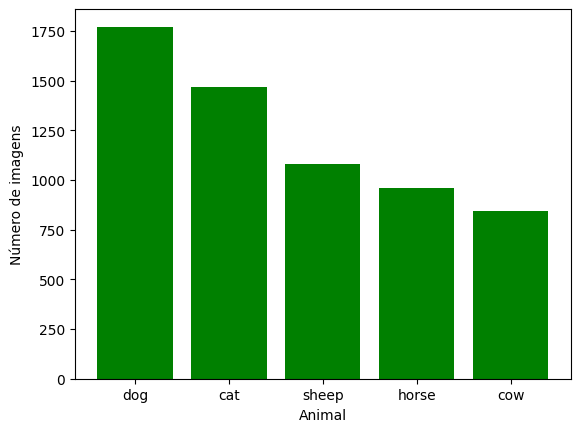

In [9]:
animais_count = {1: 0, 2: 0, 3: 0, 4: 0, 5: 0}
animais_name = {'dog':1, 'cat':2, 'sheep':3, 'horse':4,'cow':5}

for i in data['annotations']:
    animais_count[i['category_id']] += 1

plt.bar(animais_name.keys(),animais_count.values(), color='green')
plt.xlabel('Animal')
plt.ylabel('Número de imagens')
plt.show()

Através do gráfico percebe-se que a maior parte das imagens do dataset são de cachorros, enquanto que a minoria do dataset é representada por bovinos

Amostra do dataset

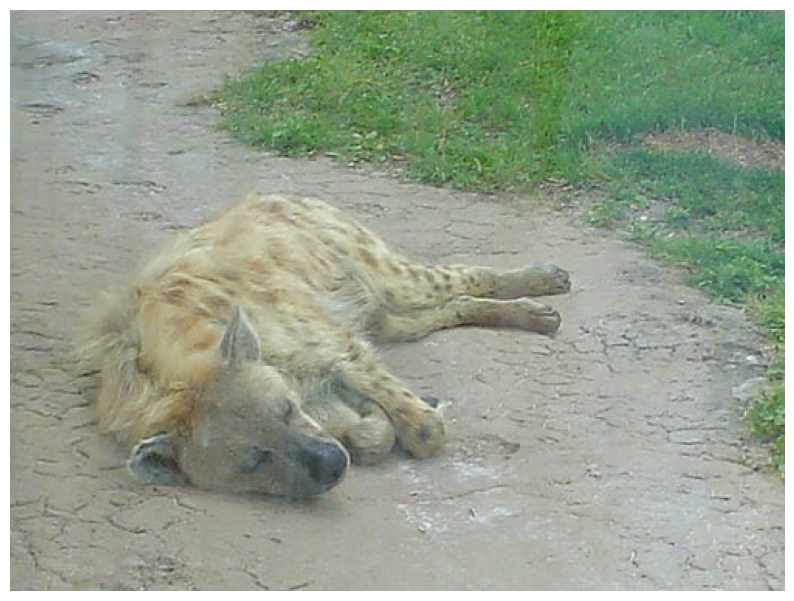

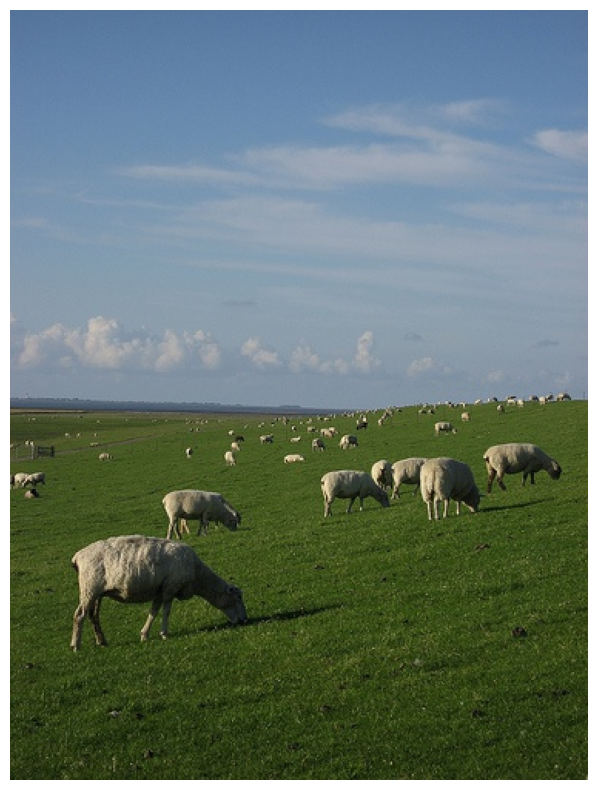

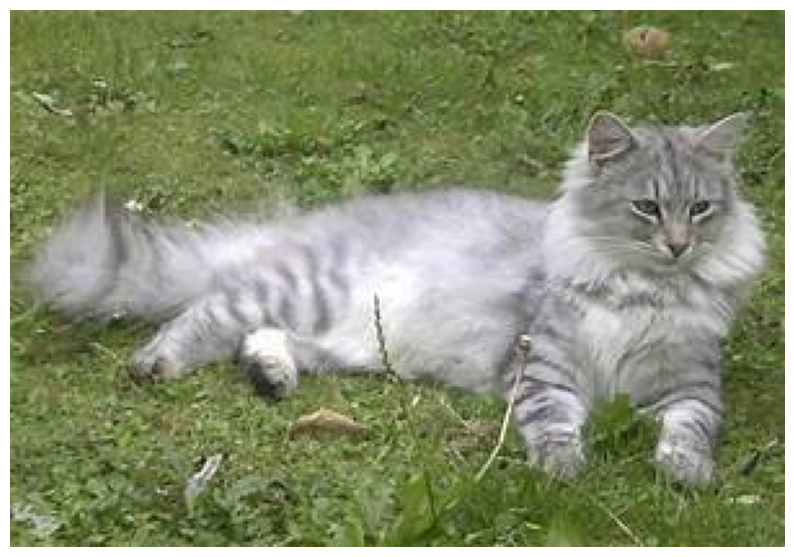

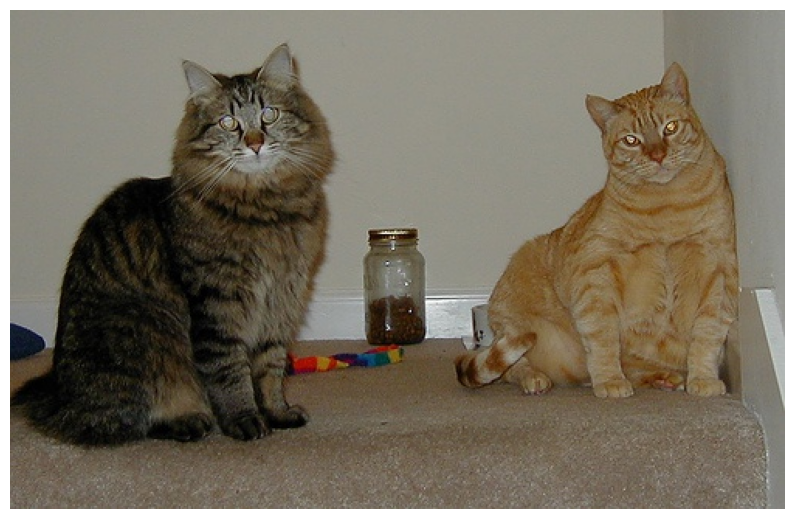

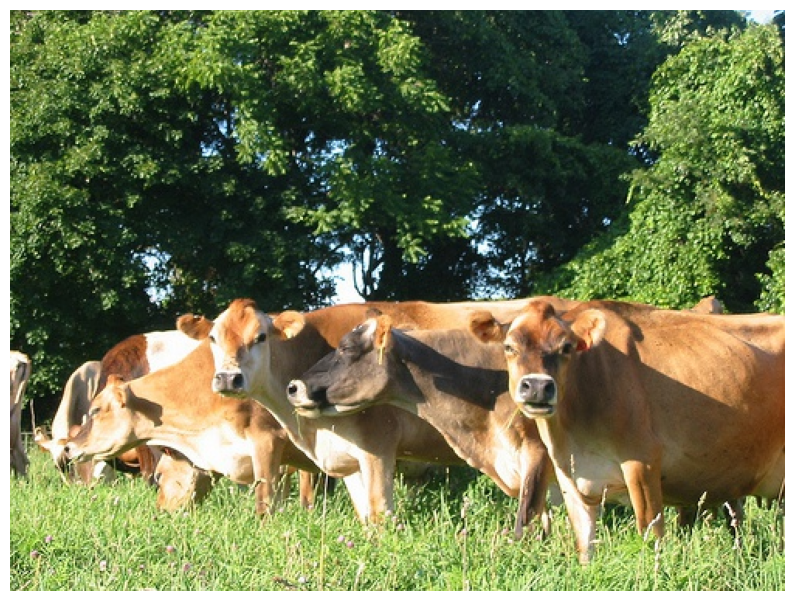

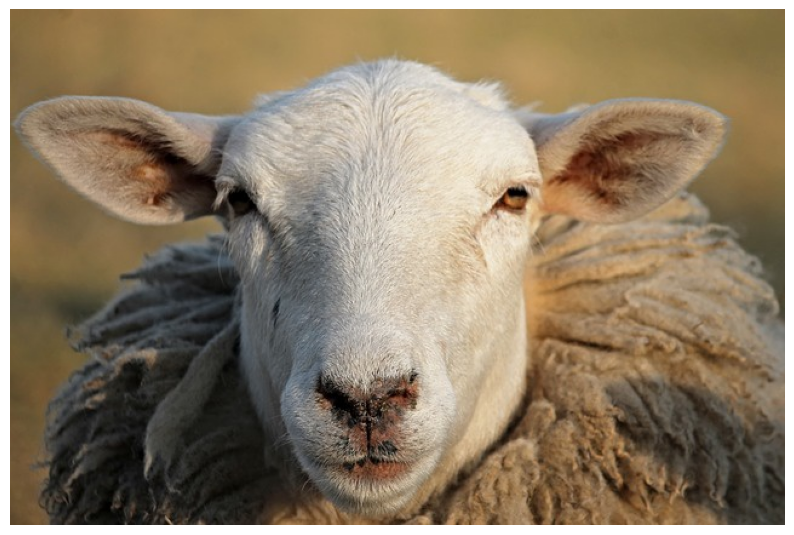

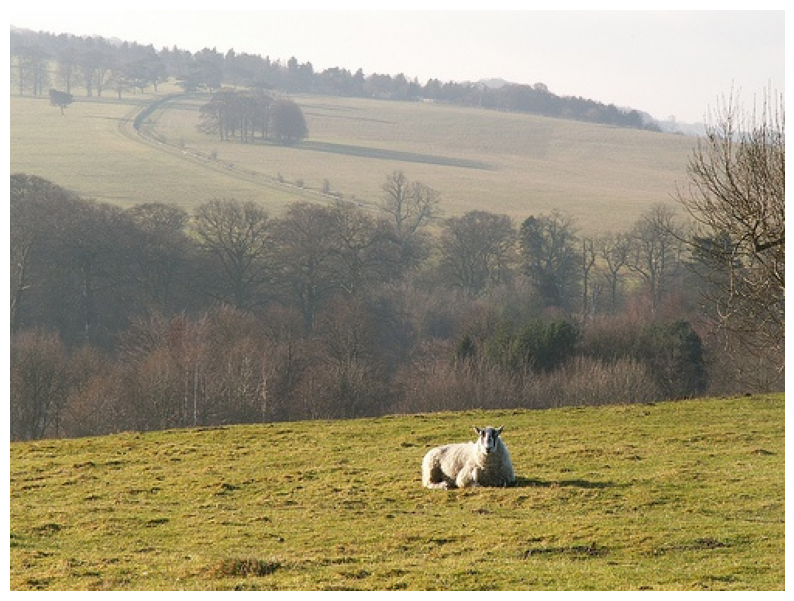

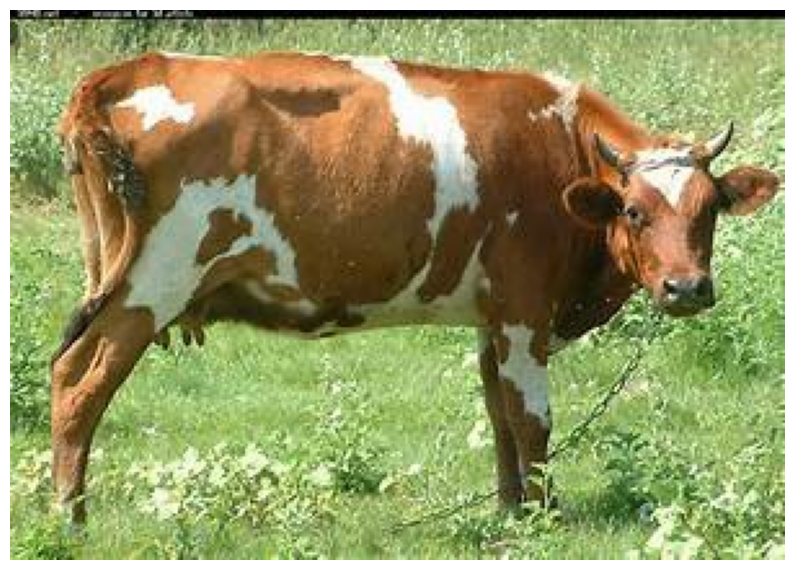

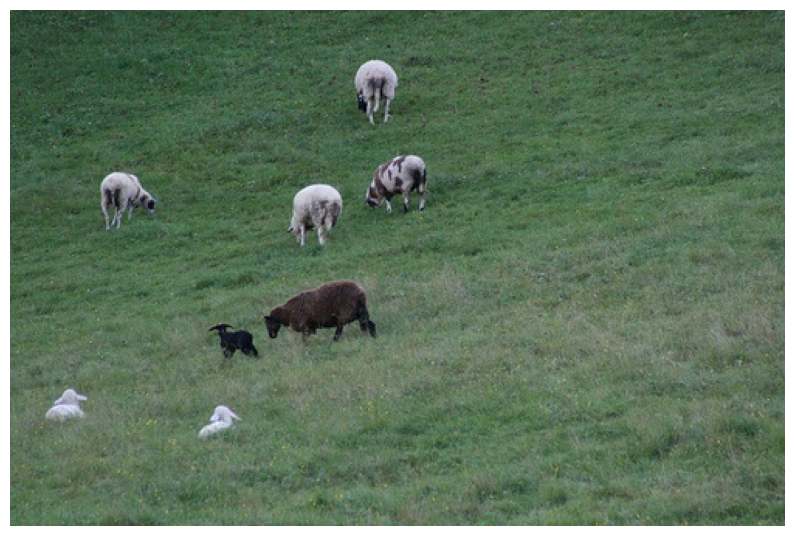

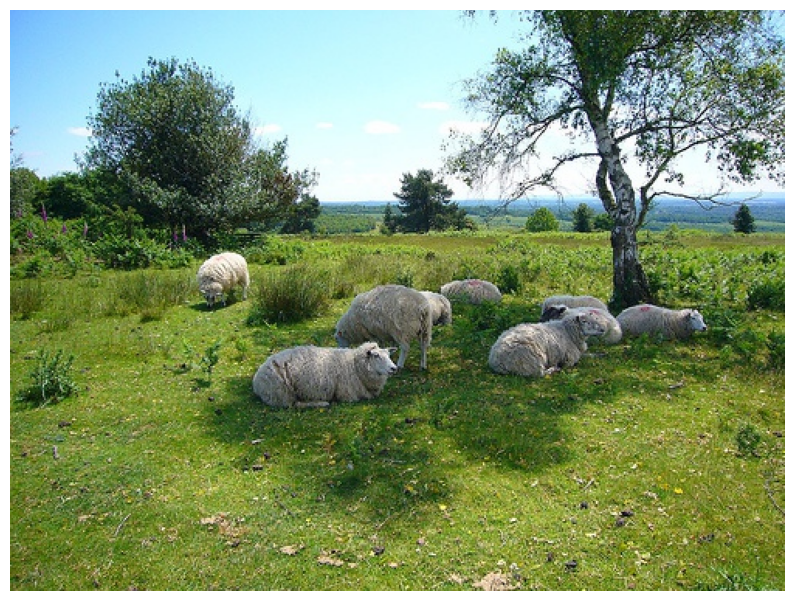

In [10]:
for i in random.sample(data['annotations'],10):
    img_nome = data['images'][f'{i["image_id"]}']
    img = cv2.imread(f'/content/images/images/{img_nome}')
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    plt.axis('off')
    plt.show()

Contagem de imagens bovinos

In [11]:

vacount = 0
total = len(data['annotations'])
for i in data['annotations']:
  if i['category_id'] == 5:
    vacount += 1
print(f'Número de imagens de bovinos: {vacount}')
print(f'Porcentagem de bovinos no dataset: {math.floor(vacount/total * 100)} %')

Número de imagens de bovinos: 842
Porcentagem de bovinos no dataset: 13 %


([<matplotlib.patches.Wedge at 0x7ac0f6c31510>,
 [Text(0.998741552407129, 0.4609938302140258, 'bovinos'),
  Text(-0.9987415524071293, -0.4609938302140255, 'outros animais')],
 [Text(0.5447681194947975, 0.2514511801167413, '13.8%'),
  Text(-0.5447681194947978, -0.25145118011674117, '86.2%')])

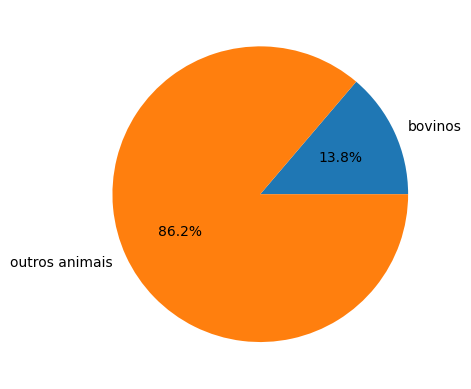

In [12]:
fig, ax = plt.subplots()
ax.pie([(vacount/total * 100), 100 - (vacount/total * 100)], labels=['bovinos', 'outros animais'], autopct='%1.1f%%')

Portanto, no dataset 842 imagens no dataset são de bovinos, representando aproximadamente 13% do total de imagens.

In [13]:
# Adicionar distribuição de keypoints por todas as imagens e pelos bovinos
animais_keypoints = {1: 0, 2: 0, 3: 0, 4: 0, 5: 0}
animais_name = {'dog':1, 'cat':2, 'sheep':3, 'horse':4,'cow':5}

for i in data['annotations']:
    animais_keypoints[i['category_id']] += i['num_keypoints']

animais_keypoints

{1: 35420, 2: 29320, 3: 21560, 4: 19200, 5: 16840}

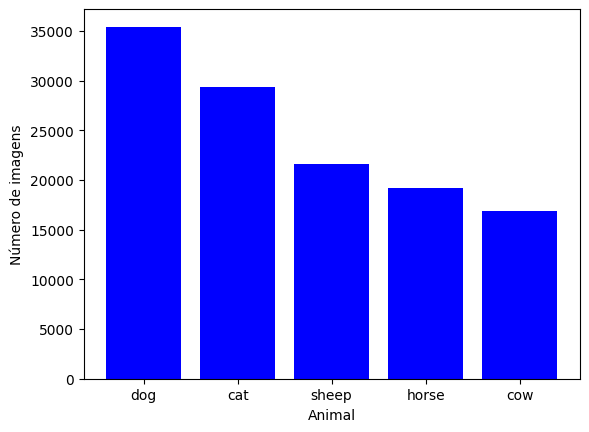

In [24]:
plt.bar(animais_name.keys(),animais_keypoints.values(), color='blue')
plt.xlabel('Animal')
plt.ylabel('Número de imagens')
plt.show()

In [14]:
numbs_keypoints = {}
for i in data['annotations']:
    numbs_keypoints[i['num_keypoints']] = numbs_keypoints.get(i['num_keypoints'], 0) + 1
numbs_keypoints

{20: 6117}

Nota-se que todas as imagens possuem o mesmo número(20) de keypoints.

## 2. Processamento Dataset

Filtragem do dataset para que somente imagens de bovinos sejam processados

In [15]:
annotations_vaca = []
for i in data['annotations']:
  if i['category_id'] == 5:
    annotations_vaca.append(i)

print(annotations_vaca[0]) #exemplo
#agora obtém-se um annotations, apenas com informações das imagens em que contém bovinos

{'image_id': 5, 'bbox': [71, 252, 216, 314], 'keypoints': [[103, 269, 1], [86, 269, 1], [92, 284, 1], [108, 260, 1], [83, 261, 1], [110, 303, 1], [0, 0, 0], [0, 0, 0], [0, 0, 0], [108, 307, 1], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [105, 289, 1], [121, 263, 1], [211, 272, 1]], 'num_keypoints': 20, 'category_id': 5}


Amostra do dataset apenas com bovinos

In [40]:
ids = [] #set do id das imagens
images_vaca = {}
for img in random.sample(annotations_vaca,842):
    if img['image_id'] not in ids: #Faço isso para não repetir imagem
        ids.append(img['image_id'])
        img_nome = data['images'][f'{img["image_id"]}']
        images_vaca[img['image_id']] = img_nome
        img = cv2.imread(f'/content/images/images/{img_nome}')
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # plt.figure(figsize=(10, 10))
        # plt.imshow(img)
        # plt.axis('off')
        # plt.show()
print(len(annotations_vaca))
print(len(ids))

842
534


Conclui-se que no dataset existem 842 imagens de bovinos,contudo dentro desse conjunto existem imagens repetidas, sendo, portanto, 534 imagens únicas.

In [39]:
annotations_vaca[0]

{'image_id': 5,
 'bbox': [71, 252, 216, 314],
 'keypoints': [[103, 269, 1],
  [86, 269, 1],
  [92, 284, 1],
  [108, 260, 1],
  [83, 261, 1],
  [110, 303, 1],
  [0, 0, 0],
  [0, 0, 0],
  [0, 0, 0],
  [108, 307, 1],
  [0, 0, 0],
  [0, 0, 0],
  [0, 0, 0],
  [0, 0, 0],
  [0, 0, 0],
  [0, 0, 0],
  [0, 0, 0],
  [105, 289, 1],
  [121, 263, 1],
  [211, 272, 1]],
 'num_keypoints': 20,
 'category_id': 5}

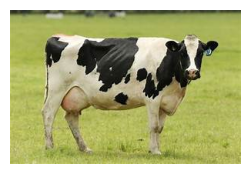

In [37]:
#Antes do redimensionamento
img_grande = cv2.imread('/content/images/images/co16.jpeg')
img_grande = cv2.cvtColor(img_grande, cv2.COLOR_BGR2RGB)
fig, ax = plt.subplots(figsize=(img_grande.shape[1] / 100, img_grande.shape[0] / 100))
ax.imshow(img_grande)
ax.axis('off')
plt.show()

2008_007544.jpg


<ipython-input-36-e8be444ff90d>:19: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  for name, image in random.sample(images.items(),10):


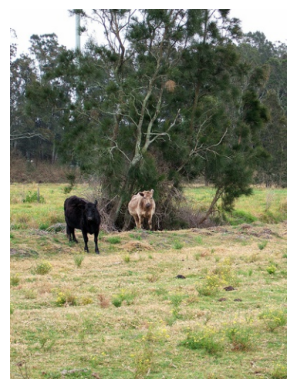

2008_008199.jpg


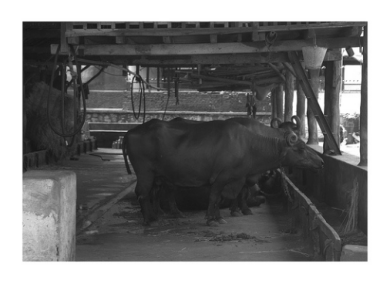

2010_005061.jpg


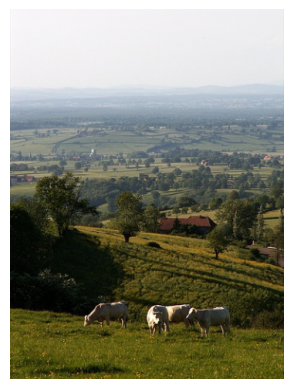

2011_002134.jpg


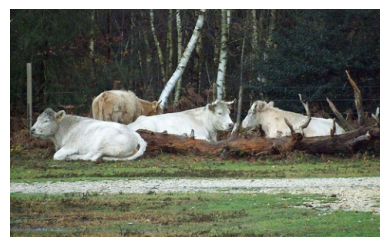

2008_008121.jpg


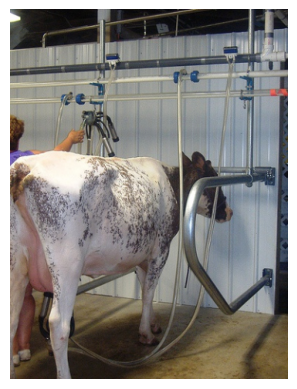

2009_001163.jpg


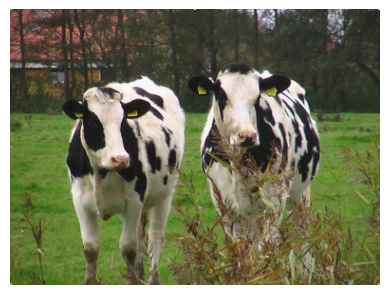

co16.jpeg


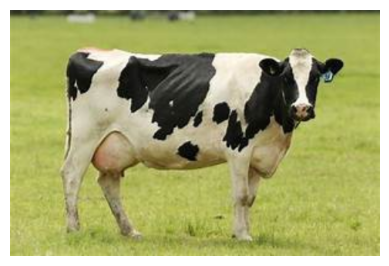

2009_002708.jpg


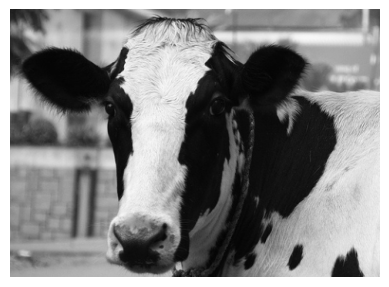

2010_004635.jpg


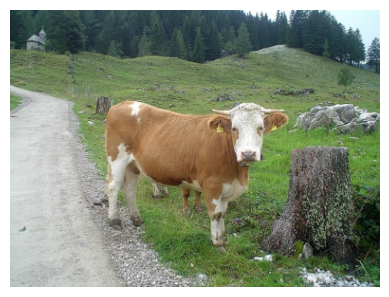

co176.jpeg


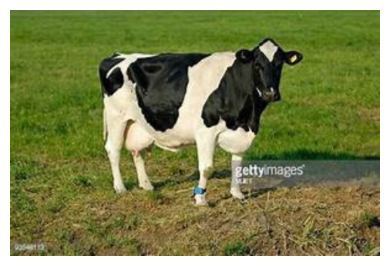

In [36]:
# Redimensionar as imagens

DESIRED_HEIGHT = 480
DESIRED_WIDTH = 480
def resize_and_show(image):
  h, w = image.shape[:2]
  if h < w:
    img = cv2.resize(image, (DESIRED_WIDTH, math.floor(h/(w/DESIRED_WIDTH))))
  else:
    img = cv2.resize(image, (math.floor(w/(h/DESIRED_HEIGHT)), DESIRED_HEIGHT))

  fig, ax = plt.subplots(figsize=(img.shape[1] / 100, img.shape[0] / 100))
  ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
  ax.axis('off')
  plt.show()
# Read images with OpenCV.
images = {name: cv2.imread(f'/content/images/images/{name}') for name in images_vaca.values()}
# Preview the images.
for name, image in random.sample(images.items(),10):
  print(name)
  resize_and_show(image)

## 3. Modelo inferência

In [18]:
!pip install mediapipe

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.9/35.9 MB 44.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.6/294.6 kB 16.8 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 3.20.3
    Uninstalling protobuf-3.20.3:
      Successfully uninstalled protobuf-3.20.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-metadata 1.15.0 requires protobuf<4.21,>=3.20.3; python_version < "3.11", but you have protobuf 4.25.5 which is incompatible.


In [19]:
print(images_vaca)

{834: '2010_001803.jpg', 484: '2008_008617.jpg', 3558: '2011_002649.jpg', 1224: '2011_000109.jpg', 515: '2009_000574.jpg', 1714: '2009_002912.jpg', 3838: 'co125.jpeg', 3392: '2011_000778.jpg', 3963: 'co58.jpeg', 1934: '2009_004451.jpg', 924: '2010_002797.jpg', 168: '2008_002278.jpg', 3371: '2011_000566.jpg', 3865: 'co15.jpeg', 3883: 'co166.jpeg', 438: '2008_007025.jpg', 1648: '2009_002422.jpg', 229: '2008_000073.jpg', 3464: '2011_001653.jpg', 432: '2008_002270.jpg', 3873: 'co157.jpeg', 1784: '2009_003455.jpg', 3889: 'co171.jpeg', 3955: 'co50.jpeg', 1754: '2009_003218.jpg', 3555: '2011_002609.jpg', 3839: 'co126.jpeg', 3907: 'co188.jpeg', 3920: 'co2.jpeg', 3946: 'co42.jpeg', 2278: '2010_001107.jpg', 1696: '2009_002772.jpg', 2015: '2009_005081.jpg', 1533: '2009_001518.jpg', 3867: 'co151.jpeg', 3972: 'co66.jpeg', 522: '2009_000626.jpg', 1606: '2009_002118.jpg', 1667: '2009_002542.jpg', 1485: '2009_001184.jpg', 4006: 'co97.jpeg', 3436: '2011_001333.jpg', 3897: 'co179.jpeg', 534: '2008_00325

In [20]:
import mediapipe as mp
mp_pose = mp.solutions.pose
mp_drawing = mp.solutions.drawing_utils
mp_drawing_styles = mp.solutions.drawing_styles

help(mp_pose.Pose)

Help on class Pose in module mediapipe.python.solutions.pose:

class Pose(mediapipe.python.solution_base.SolutionBase)
 |  Pose(static_image_mode=False, model_complexity=1, smooth_landmarks=True, enable_segmentation=False, smooth_segmentation=True, min_detection_confidence=0.5, min_tracking_confidence=0.5)
 |  
 |  MediaPipe Pose.
 |  
 |  MediaPipe Pose processes an RGB image and returns pose landmarks on the most
 |  prominent person detected.
 |  
 |  Please refer to https://solutions.mediapipe.dev/pose#python-solution-api for
 |  usage examples.
 |  
 |  Method resolution order:
 |      Pose
 |      mediapipe.python.solution_base.SolutionBase
 |      builtins.object
 |  
 |  Methods defined here:
 |  
 |  __init__(self, static_image_mode=False, model_complexity=1, smooth_landmarks=True, enable_segmentation=False, smooth_segmentation=True, min_detection_confidence=0.5, min_tracking_confidence=0.5)
 |      Initializes a MediaPipe Pose object.
 |      
 |      Args:
 |        static_i

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


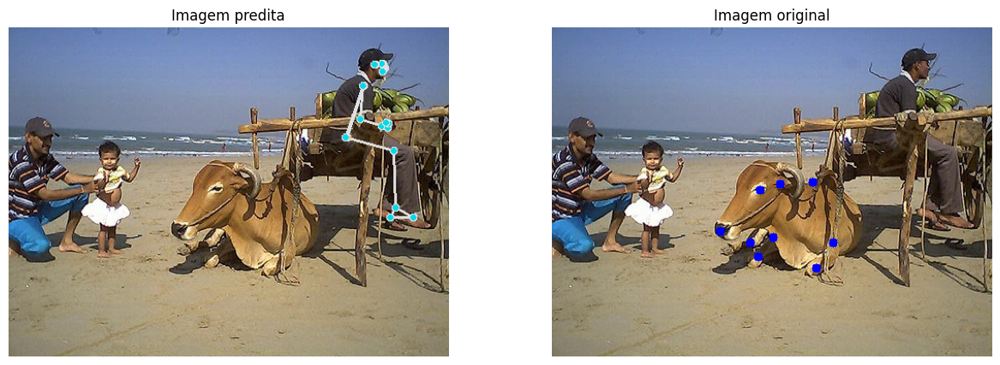

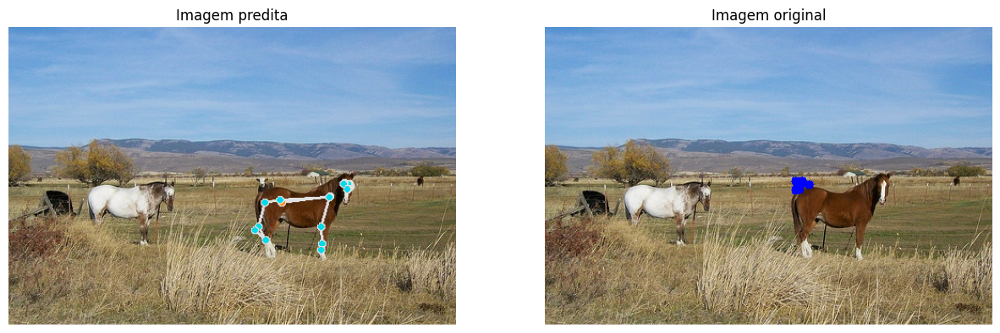

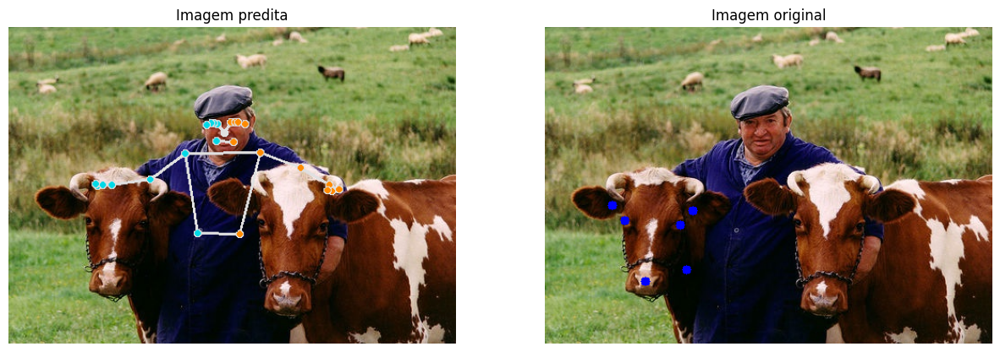

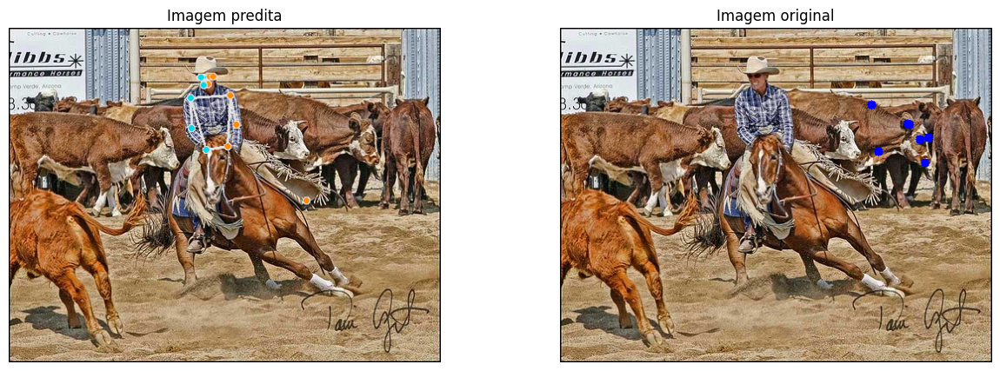

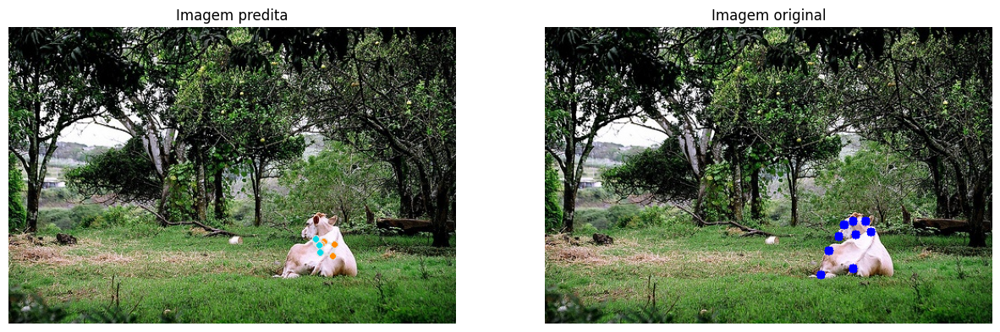

...

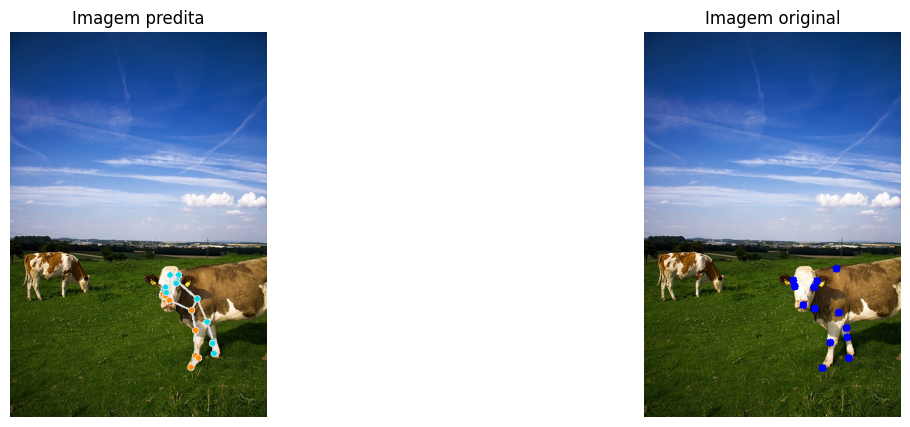

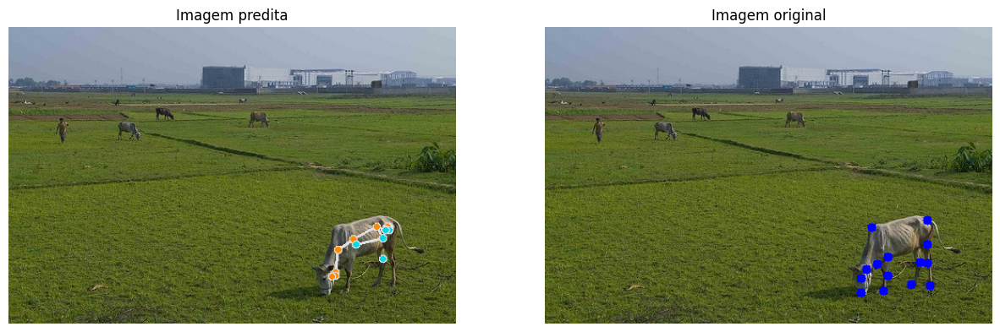

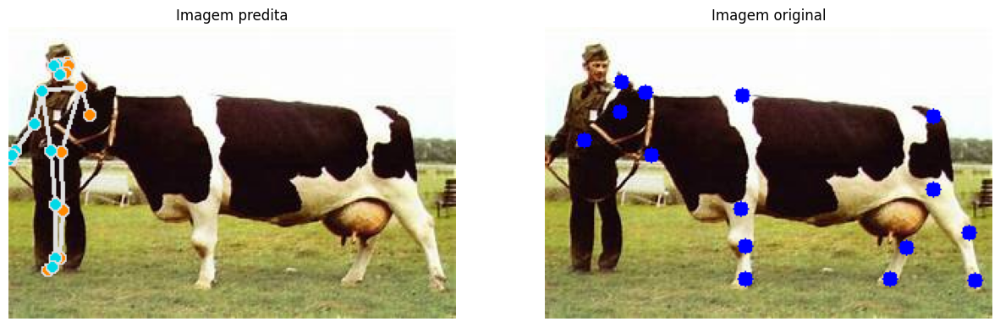

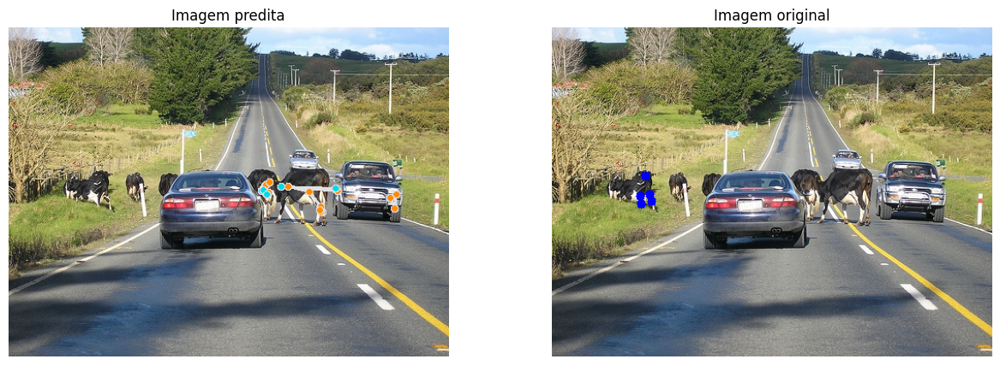

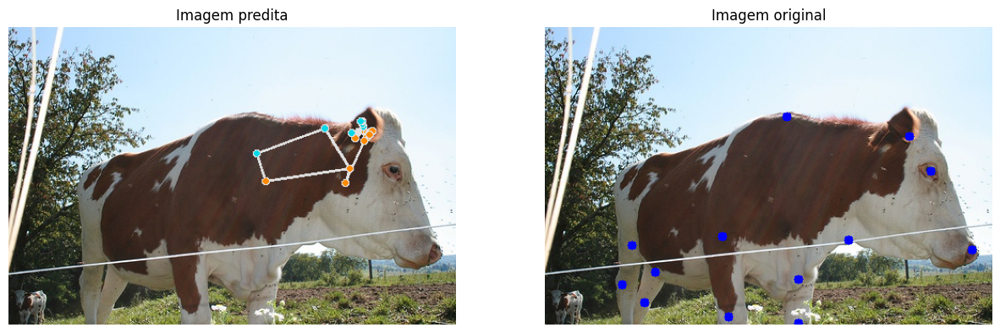

In [41]:
import cv2
import matplotlib.pyplot as plt
import mediapipe as mp

mp_pose = mp.solutions.pose
mp_drawing = mp.solutions.drawing_utils
mp_drawing_styles = mp.solutions.drawing_styles


def draw_keypoints(image, keypoints):
    for keypoint in keypoints:
        x, y, visibility = keypoint
        if visibility > 0:
            cv2.circle(image, (int(x), int(y)), 5, (255, 0, 0), -1)


def process_and_plot(image, keypoints_annotated, count_preditas = 0):
    with mp_pose.Pose(static_image_mode=True, min_detection_confidence=0.5, model_complexity=2) as pose:
        # Convert BGR to RGB para MediaPipe
        results = pose.process(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

        # Se a predição falhar, ignorar
        if not results.pose_landmarks:
            return

        # Copiar a imagem para desenhar keypoints preditos
        annotated_image = image.copy()
        predicted_image = image.copy()

        draw_keypoints(annotated_image, keypoints_annotated)

        mp_drawing.draw_landmarks(
            predicted_image,
            results.pose_landmarks,
            mp_pose.POSE_CONNECTIONS,
            landmark_drawing_spec=mp_drawing_styles.get_default_pose_landmarks_style())

        count_preditas += 1

        fig, axs = plt.subplots(1, 2, figsize=(15, 5))
        axs[0].imshow(cv2.cvtColor(predicted_image, cv2.COLOR_BGR2RGB))
        axs[0].set_title("Imagem predita")
        axs[0].axis('off')
        axs[1].imshow(cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB))
        axs[1].set_title("Imagem original")
        axs[1].axis('off')
        plt.show()
        return count_preditas




images_unicas = []
for i in random.sample(annotations_vaca,100):
  image = cv2.imread(f'/content/images/images/{images_vaca[i["image_id"]]}')
  keypoints_annotated = i['keypoints']
  count_preditas = process_and_plot(image, keypoints_annotated, 0)


| Total de imagens | Imagens preditas | Bovinos preditos  | Humanos preditos |
| ------------- | ------------- | ------------- | ------------- |
| 100  | 15  | 6 | 8  |


In [23]:
# Run MediaPipe Pose and draw pose landmarks.
with mp_pose.Pose(
    static_image_mode=True, min_detection_confidence=0.5, model_complexity=2) as pose:
  count_preditas = 0
  for image_id, image in images_vaca.items():  # image_id é a chave, image é o valor (imagem processada)
    print(f'Processing image ID: {image_id}')

    # Se o valor no dicionário for o nome da imagem, você precisará carregar a imagem
    if isinstance(image, str):
      image = cv2.imread(f'/content/images/images/{image}')

    # Convert the BGR image to RGB and process it with MediaPipe Pose.
    results = pose.process(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

    # Print nose landmark.
    image_hight, image_width, _ = image.shape
    if not results.pose_landmarks:
      continue

    annotated_image = image.copy()
    mp_drawing.draw_landmarks(
        annotated_image,
        results.pose_landmarks,
        mp_pose.POSE_CONNECTIONS,
        landmark_drawing_spec=mp_drawing_styles.get_default_pose_landmarks_style())
    count_preditas += 1

print(f'count_preditas: {count_preditas}')

Processing image ID: 834
Processing image ID: 484
Processing image ID: 3558
Processing image ID: 1224
Processing image ID: 515
Processing image ID: 1714
Processing image ID: 3838
Processing image ID: 3392
Processing image ID: 3963
Processing image ID: 1934
Processing image ID: 924
Processing image ID: 168
Processing image ID: 3371
Processing image ID: 3865
Processing image ID: 3883
Processing image ID: 438
Processing image ID: 1648
Processing image ID: 229
Processing image ID: 3464
Processing image ID: 432
Processing image ID: 3873
Processing image ID: 1784
Processing image ID: 3889
Processing image ID: 3955
Processing image ID: 1754
Processing image ID: 3555
Processing image ID: 3839
Processing image ID: 3907
Processing image ID: 3920
Processing image ID: 3946
Processing image ID: 2278
Processing image ID: 1696
Processing image ID: 2015
Processing image ID: 1533
Processing image ID: 3867
Processing image ID: 3972
Processing image ID: 522
Processing image ID: 1606
Processing image ID: 

De todas as 534 imagens únicas apenas 58 foram preditas.